In [1]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import numpy as np
import shapely.geometry
import shapely
from shapely import wkt
import rasterio
from rasterio import features
import rioxarray
from rasterio.features import shapes
from rasterio.enums import MergeAlg
from rasterio.plot import show
from numpy import int16
from shapely.geometry import shape
import matplotlib.pyplot as plt
from pathlib import Path
import shapely.plotting
from shapely.geometry import Polygon

import shapely.wkt
import shapely.geometry

len wind =  6662
len Solar =  30098


<Axes: >

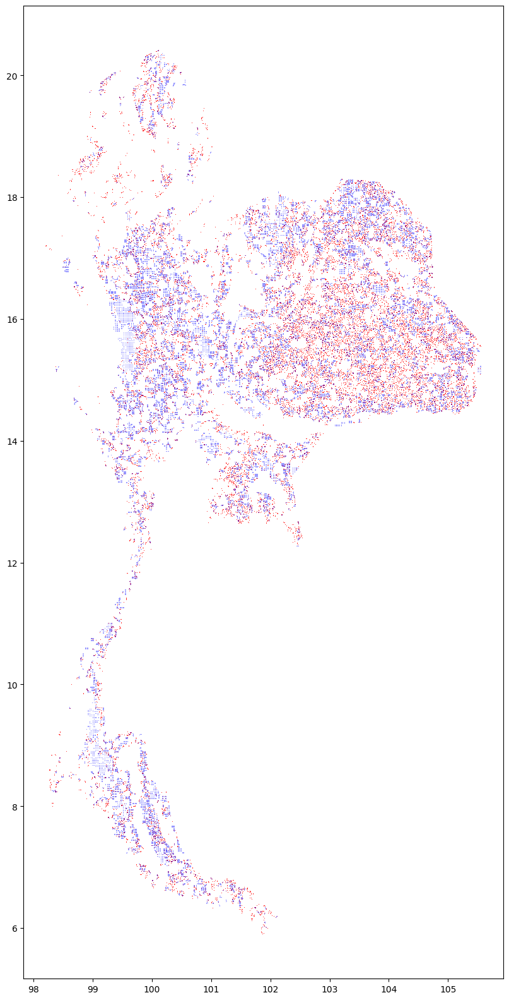

In [2]:
df_final_SI_Wind = pd.read_csv('Output_SolarWind\\df_final_SI_Wind.csv')
df_final_SI_Solar = pd.read_csv('Output_SolarWind\\df_final_SI_Solar.csv')
df_final_SI_Wind['geometry'] = df_final_SI_Wind['geometry'].apply(wkt.loads)
df_final_SI_Solar['geometry'] = df_final_SI_Solar['geometry'].apply(wkt.loads)
gdp_final_SI_Wind = gpd.GeoDataFrame(df_final_SI_Wind, crs='epsg:4326')
gdp_final_SI_Solar = gpd.GeoDataFrame(df_final_SI_Solar, crs='epsg:4326')

gdp_final_SI_Wind = gdp_final_SI_Wind.drop(columns=['raster_val','center'])
gdp_final_SI_Solar = gdp_final_SI_Solar.drop(columns=['raster_val','center'])

print("len wind = ",len(gdp_final_SI_Wind))
print("len Solar = ",len(gdp_final_SI_Solar))

fig, ax = plt.subplots(figsize=(20,20))
gdp_final_SI_Solar.geometry.plot(ax = ax, color='red',alpha = 0.8,zorder = 0)
gdp_final_SI_Wind.geometry.plot(ax = ax, color='blue',alpha = 0.4,zorder = 1)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


<Axes: >

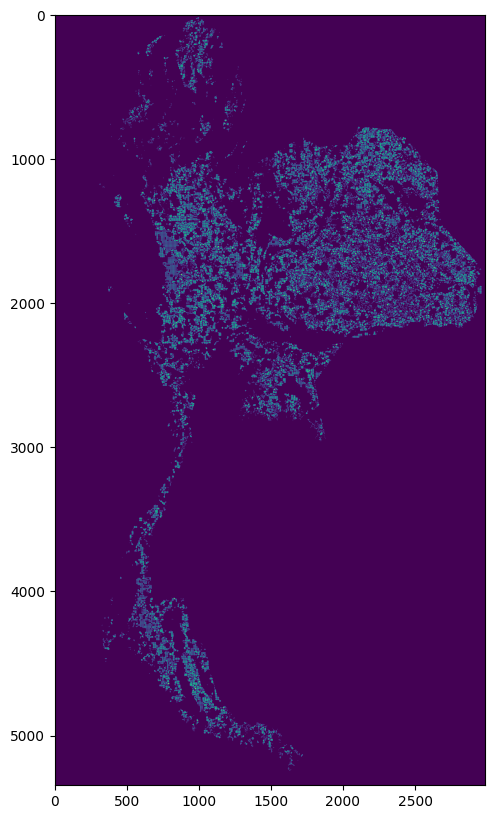

In [3]:
xr_rasterized_wind = rasterio.open('Output_SolarWind\\xr_AVA_Wind.nc')
geom = [shapes for shapes in gdp_final_SI_Wind.geometry]

rasterized_wind = features.rasterize(geom,
                                out_shape = xr_rasterized_wind.shape,
                                fill = 0,
                                out = None,
                                transform = xr_rasterized_wind.transform,
                                all_touched = True,
                                default_value = 1,
                                dtype = None)

xr_rasterized_solar = rasterio.open('Output_SolarWind\\xr_AVA_solar.nc')
geom = [shapes for shapes in gdp_final_SI_Solar.geometry]

rasterized_solar = features.rasterize(geom,
                                out_shape = xr_rasterized_solar.shape,
                                fill = 0,
                                out = None,
                                transform = xr_rasterized_solar.transform,
                                all_touched = True,
                                default_value = 1,
                                dtype = None)


rasterized = rasterized_wind+rasterized_solar
print(rasterized)
# Plot raster
fig, ax = plt.subplots(1, figsize = (10, 10))
show(rasterized, ax = ax)
plt.gca()

<xarray.Dataset>
Dimensions:  (lat: 5346, lon: 2985)
Coordinates:
  * lat      (lat) float64 5.615 5.618 5.621 5.624 ... 20.45 20.46 20.46 20.46
  * lon      (lon) float64 97.35 97.35 97.35 97.35 ... 105.6 105.6 105.6 105.6
Data variables:
    v        (lat, lon) int32 0 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0


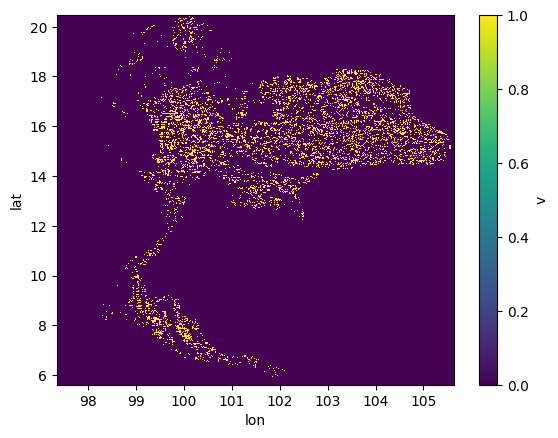

In [4]:
xr_format= xr.open_dataset('Output_SolarWind\\xr_AVA_Wind.nc')
lat = list(xr_format.lat)
lon = list(xr_format.lon)

rasterized_i = rasterized[::-1]

r = xr.DataArray(
    data = rasterized_i,
    coords = dict(
        lat = ('lat',lat),
        lon = ('lon',lon),

    )
)

xr_r = r.to_dataset(name="v")
xr_r['v'] = xr.where( (xr_r['v'] > 0),1,0)
xr_r.to_netcdf(path='Output_SolarWind\\xr_rasterized_largepolygon.nc')
print(xr_r)
xr_r['v'].plot()

In [5]:
mask = None
with rasterio.Env():
    with rasterio.open('Output_SolarWind\\xr_rasterized_largepolygon.nc') as src:
        image = src.read(1) # first band
        results = (
        {'properties': {'raster_val': v}, 'geometry': s}
        for i, (s, v) 
        in enumerate(
            shapes(image, mask=mask, transform=src.transform)))

geoms = list(results)

gpd_polygonized_raster  = gpd.GeoDataFrame.from_features(geoms)
gpd_polygonized_raster.crs = {'init': 'epsg:4326'}
gpd_polygonized_raster= gpd_polygonized_raster.to_crs({'init': 'epsg:3857'})
gpd_polygonized_raster['area'] = gpd_polygonized_raster['geometry'].area / (10**6)
gpd_polygonized_raster['area'] = round(gpd_polygonized_raster['area'],4)
gpd_polygonized_raster = gpd_polygonized_raster.to_crs({'init': 'epsg:4326'})
gpd_polygonized_raster = gpd_polygonized_raster.loc[gpd_polygonized_raster['raster_val'] == 1]
gpd_polygonized_raster.reset_index(inplace=True,drop=True)
gpd_polygonized_raster.reset_index(inplace=True)
gpd_polygonized_raster = gpd_polygonized_raster.rename(columns = {'index' : 'pol_id'})

print(gpd_polygonized_raster)

C:\Users\basna\AppData\Roaming\Python\Python311\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\basna\AppData\Roaming\Python\Python311\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\basna\AppData\Roaming\Python\Python311\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the prefe

       pol_id                                           geometry  raster_val  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...         1.0   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...         1.0   
2           2  POLYGON ((99.99167 20.36944, 99.99444 20.36944...         1.0   
3           3  POLYGON ((100.15000 20.35556, 100.15000 20.352...         1.0   
4           4  POLYGON ((100.16667 20.37222, 100.18611 20.372...         1.0   
...       ...                                                ...         ...   
24198   24198  POLYGON ((101.84167 5.95000, 101.84444 5.95000...         1.0   
24199   24199  POLYGON ((101.89722 5.91944, 101.89722 5.91667...         1.0   
24200   24200  POLYGON ((101.83611 5.93056, 101.83611 5.92778...         1.0   
24201   24201  POLYGON ((101.88889 5.91667, 101.88889 5.90556...         1.0   
24202   24202  POLYGON ((101.87500 5.90833, 101.87778 5.90833...         1.0   

         area  
0      4.9990  
1      

In [6]:
df_final_SI_Wind = pd.read_csv('Output_SolarWind\\df_final_SI_Wind.csv')
df_final_SI_Solar = pd.read_csv('Output_SolarWind\\df_final_SI_Solar.csv')
df_final_SI_Wind['area'] = round(df_final_SI_Wind['area'],4)
df_final_SI_Solar['area'] = round(df_final_SI_Solar['area'],4)

df_final_SI_Wind['geometry'] = df_final_SI_Wind['geometry'].apply(wkt.loads)
df_final_SI_Solar['geometry'] = df_final_SI_Solar['geometry'].apply(wkt.loads)
gdp_final_SI_Wind = gpd.GeoDataFrame(df_final_SI_Wind, crs='epsg:4326')
gdp_final_SI_Solar = gpd.GeoDataFrame(df_final_SI_Solar, crs='epsg:4326')
gdp_final_SI_Wind = gdp_final_SI_Wind.set_geometry(gdp_final_SI_Wind['geometry'])
gdp_final_SI_Solar = gdp_final_SI_Solar.set_geometry(gdp_final_SI_Solar['geometry'])

gdp_final_SI_Wind.reset_index(inplace=True,drop=True)
gdp_final_SI_Solar.reset_index(inplace=True,drop=True)

print(gdp_final_SI_Wind)
print(gdp_final_SI_Solar)

      pol_id_wind                                           geometry  \
0               0  POLYGON ((100.10833 20.41667, 100.11944 20.416...   
1               1  POLYGON ((99.99167 20.36944, 99.99444 20.36944...   
2               2  POLYGON ((99.98611 20.33611, 99.98889 20.33611...   
3               3  POLYGON ((99.88889 20.31944, 99.90556 20.31944...   
4               4  POLYGON ((100.03611 20.34167, 100.05000 20.341...   
...           ...                                                ...   
6657         6657  POLYGON ((100.74119 6.68007, 100.74119 6.70511...   
6658         6658  POLYGON ((101.45044 6.48656, 101.45044 6.51483...   
6659         6659  POLYGON ((101.48933 6.52683, 101.48933 6.55511...   
6660         6660  POLYGON ((101.46711 6.35044, 101.46711 6.38011...   
6661         6661  POLYGON ((101.46711 6.39211, 101.46711 6.42178...   

      raster_val     area                                         center  \
0              3   5.1010  POINT (100.09849999999997 20.405

In [7]:
gpd_polygonized_raster['from_pol_id_wind'] = 0
gpd_polygonized_raster['list_pol_id_wind'] = None
gpd_polygonized_raster['SI_Wind'] = 0
gpd_polygonized_raster['area_wind'] = 0
gpd_polygonized_raster['coord_wind'] = 0

gpd_polygonized_raster['from_pol_id_solar'] = 0
gpd_polygonized_raster['list_pol_id_solar'] = None
gpd_polygonized_raster['SI_Solar'] = 0
gpd_polygonized_raster['area_solar'] = 0
gpd_polygonized_raster['coord_solar'] = 0

for i , pol in enumerate(gpd_polygonized_raster['geometry']):
    ##################################### WINNNDD ###########################################################################################################
    gpd_polygonized_raster['from_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].count()
    if(gpd_polygonized_raster['from_pol_id_wind'][i] > 1 ):
        # gpd_polygonized_raster['list_pol_id_wind'][i] = [id for id in gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].values]
        # print(gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].values)
        gpd_polygonized_raster['list_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].values
        buffer = [poly for poly in (gdp_final_SI_Wind['geometry'].loc[gdp_final_SI_Wind['geometry'].within(pol)])]
        gpd_polygonized_raster['coord_wind'][i] = shapely.geometry.MultiPolygon(buffer)
        gpd_polygonized_raster['SI_Wind'][i] = gdp_final_SI_Wind['final_SI_Wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].mean() 
        # print("wind = ",gpd_polygonized_raster['from_pol_wind_id'][i],gpd_polygonized_raster['wind_area_coord'][i])
    else:
        if(gpd_polygonized_raster['from_pol_id_wind'][i] == 1 ):
            gpd_polygonized_raster['list_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].values
            buffer = gdp_final_SI_Wind['geometry'].loc[gdp_final_SI_Wind['geometry'].within(pol)]
            buffer = buffer.reset_index()
            gpd_polygonized_raster['coord_wind'][i] = buffer['geometry'][0]
            gpd_polygonized_raster['SI_Wind'][i] = gdp_final_SI_Wind['final_SI_Wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].mean() 
        else:
            gpd_polygonized_raster['list_pol_id_wind'][i] = None
            gpd_polygonized_raster['from_pol_id_wind'][i] = 0
            gpd_polygonized_raster['coord_wind'][i] = None
            gpd_polygonized_raster['SI_Wind'][i] = 0
    gpd_polygonized_raster['area_wind'][i] = (gdp_final_SI_Wind['area'].loc[gdp_final_SI_Wind['geometry'].within(pol)]).sum()
    ##################################### WINNNDD ###########################################################################################################

    ##################################### Solar ###########################################################################################################
    gpd_polygonized_raster['from_pol_id_solar'][i] = gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].count()
    if(gpd_polygonized_raster['from_pol_id_solar'][i] > 1 ):
        # gpd_polygonized_raster['list_pol_id_solar'][i] = [id for id in gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].values]
        # print(gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].values)
        gpd_polygonized_raster['list_pol_id_solar'][i] = gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].values
        buffer = [poly for poly in (gdp_final_SI_Solar['geometry'].loc[gdp_final_SI_Solar['geometry'].within(pol)])]
        gpd_polygonized_raster['coord_solar'][i] = shapely.geometry.MultiPolygon(buffer)
        gpd_polygonized_raster['SI_Solar'][i] = gdp_final_SI_Solar['final_SI_Solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].mean()   
        # print("solar = ",gpd_polygonized_raster['from_pol_solar_id'][i],gpd_polygonized_raster['solar_area_coord'][i])
    else:
        if(gpd_polygonized_raster['from_pol_id_solar'][i] == 1 ):
            gpd_polygonized_raster['list_pol_id_solar'][i] = gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].values
            buffer = gdp_final_SI_Solar['geometry'].loc[gdp_final_SI_Solar['geometry'].within(pol)]
            buffer = buffer.reset_index()
            gpd_polygonized_raster['coord_solar'][i] = buffer['geometry'][0]
            gpd_polygonized_raster['SI_Solar'][i] = gdp_final_SI_Solar['final_SI_Solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].mean()
        else:
            gpd_polygonized_raster['list_pol_id_solar'][i] = None
            gpd_polygonized_raster['from_pol_id_solar'][i] = 0
            gpd_polygonized_raster['coord_solar'][i] = None
            gpd_polygonized_raster['SI_Solar'][i] = 0
    gpd_polygonized_raster['area_solar'][i] = (gdp_final_SI_Solar['area'].loc[gdp_final_SI_Solar['geometry'].within(pol)]).sum()
    ##################################### Solar ###########################################################################################################
    
try:
    gpd_polygonized_raster = gpd_polygonized_raster.drop(columns='raster_val')
except:
    None
    
print(gpd_polygonized_raster)
gpd_polygonized_raster.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv',index=False)

C:\Users\basna\AppData\Local\Temp\ipykernel_3028\2381424878.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['from_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].count()
C:\Users\basna\AppData\Local\Temp\ipykernel_3028\2381424878.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['list_pol_id_wind'][i] = None
C:\Users\basna\AppData\Local\Temp\ipykernel_3028\2381424878.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas

C:\Users\basna\AppData\Local\Temp\ipykernel_3028\2381424878.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['from_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].count()
C:\Users\basna\AppData\Local\Temp\ipykernel_3028\2381424878.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['list_pol_id_wind'][i] = None
C:\Users\basna\AppData\Local\Temp\ipykernel_3028\2381424878.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas

       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  4.9990   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...  2.3463   
2           2  POLYGON ((99.99167 20.36944, 99.99444 20.36944...  5.3033   
3           3  POLYGON ((100.15000 20.35556, 100.15000 20.352...  0.2040   
4           4  POLYGON ((100.16667 20.37222, 100.18611 20.372...  5.8134   
...       ...                                                ...     ...   
24198   24198  POLYGON ((101.84167 5.95000, 101.84444 5.95000...  2.0188   
24199   24199  POLYGON ((101.89722 5.91944, 101.89722 5.91667...  0.0961   
24200   24200  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  2.5955   
24201   24201  POLYGON ((101.88889 5.91667, 101.88889 5.90556...  0.6729   
24202   24202  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.6342   

       from_pol_id_wind list_pol_id_wind   SI_Wind  area_wind  \
0                     

In [8]:
region = pd.read_csv('Data\\Region.csv',index_col=False)
thailandmap = gpd.read_file('Data\\tha_admbnda_adm1_rtsd_20220121\\tha_admbnda_adm1_rtsd_20220121.shp')

thailandmap.crs = {'init': 'epsg:4326'}
list_region = []

count = 0
for i in thailandmap['ADM1_TH']:
    r = region['region'].loc[region['province'] == i]
    try : 
        # print(i,r.values[0])
        list_region.append(r.values[0])
    except :
        print(i,'xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')
        list_region.append('xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')       
    
thailandmap['region'] = list_region
thailandmap['center'] = thailandmap['geometry'].centroid
thailandmap = thailandmap.set_geometry('center')
thailandmap = thailandmap.drop(columns = 'geometry')

gpd_polygonized_raster['region'] = 'unk'
gpd_polygonized_raster['center'] = gpd_polygonized_raster['geometry'].centroid
gpd_polygonized_raster = gpd_polygonized_raster.set_geometry('center')


C:\Users\basna\AppData\Roaming\Python\Python311\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\basna\AppData\Local\Temp\ipykernel_3028\561258906.py:18: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  thailandmap['center'] = thailandmap['geometry'].centroid
C:\Users\basna\AppData\Local\Temp\ipykernel_3028\561258906.py:23: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gpd_polygonized_raster['cent

In [9]:
gpd_polygonized_raster_2 = gpd.sjoin_nearest(gpd_polygonized_raster,thailandmap,how='left')
print(gpd_polygonized_raster_2)

C:\Users\basna\AppData\Roaming\Python\Python311\site-packages\geopandas\array.py:364: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_nearest' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  warnings.warn(


       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  4.9990   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...  2.3463   
2           2  POLYGON ((99.99167 20.36944, 99.99444 20.36944...  5.3033   
3           3  POLYGON ((100.15000 20.35556, 100.15000 20.352...  0.2040   
4           4  POLYGON ((100.16667 20.37222, 100.18611 20.372...  5.8134   
...       ...                                                ...     ...   
24198   24198  POLYGON ((101.84167 5.95000, 101.84444 5.95000...  2.0188   
24199   24199  POLYGON ((101.89722 5.91944, 101.89722 5.91667...  0.0961   
24200   24200  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  2.5955   
24201   24201  POLYGON ((101.88889 5.91667, 101.88889 5.90556...  0.6729   
24202   24202  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.6342   

       from_pol_id_wind list_pol_id_wind   SI_Wind  area_wind  \
0                     

In [10]:
print(gpd_polygonized_raster_2.columns)
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop(columns=
                                                         ['index_right'
                                                          ,'Shape_Leng'
                                                          ,'Shape_Area'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1_PCODE'
                                                          ,'ADM1_REF'
                                                          ,'ADM1ALT1EN'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1ALT1TH'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1ALT1TH'
                                                          ,'ADM1ALT2TH'
                                                          ,'ADM0_EN'
                                                          ,'ADM0_TH'
                                                          ,'ADM0_PCODE'
                                                          ,'date'
                                                          ,'validOn'
                                                          ,'validTo'
                                                          ,'center'
                                                          ])
print(gpd_polygonized_raster_2.columns)

Index(['pol_id', 'geometry', 'area', 'from_pol_id_wind', 'list_pol_id_wind',
       'SI_Wind', 'area_wind', 'coord_wind', 'from_pol_id_solar',
       'list_pol_id_solar', 'SI_Solar', 'area_solar', 'coord_solar',
       'region_left', 'center', 'index_right', 'Shape_Leng', 'Shape_Area',
       'ADM1_EN', 'ADM1_TH', 'ADM1_PCODE', 'ADM1_REF', 'ADM1ALT1EN',
       'ADM1ALT2EN', 'ADM1ALT1TH', 'ADM1ALT2TH', 'ADM0_EN', 'ADM0_TH',
       'ADM0_PCODE', 'date', 'validOn', 'validTo', 'region_right'],
      dtype='object')
Index(['pol_id', 'geometry', 'area', 'from_pol_id_wind', 'list_pol_id_wind',
       'SI_Wind', 'area_wind', 'coord_wind', 'from_pol_id_solar',
       'list_pol_id_solar', 'SI_Solar', 'area_solar', 'coord_solar',
       'region_left', 'ADM1_EN', 'ADM1_TH', 'region_right'],
      dtype='object')


In [11]:
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop(columns = 'region_left')
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.rename(columns= {'region_right':'region'})
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop_duplicates('pol_id')
print(gpd_polygonized_raster_2)

       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  4.9990   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...  2.3463   
2           2  POLYGON ((99.99167 20.36944, 99.99444 20.36944...  5.3033   
3           3  POLYGON ((100.15000 20.35556, 100.15000 20.352...  0.2040   
4           4  POLYGON ((100.16667 20.37222, 100.18611 20.372...  5.8134   
...       ...                                                ...     ...   
24198   24198  POLYGON ((101.84167 5.95000, 101.84444 5.95000...  2.0188   
24199   24199  POLYGON ((101.89722 5.91944, 101.89722 5.91667...  0.0961   
24200   24200  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  2.5955   
24201   24201  POLYGON ((101.88889 5.91667, 101.88889 5.90556...  0.6729   
24202   24202  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.6342   

       from_pol_id_wind list_pol_id_wind   SI_Wind  area_wind  \
0                     

In [12]:
gpd_polygonized_raster_2.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv',index=False,encoding="utf-8-sig")

In [2]:
df = pd.read_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv')
df = df.drop(columns=[
    'geometry',
    'coord_wind',
    'coord_solar',
    'ADM1_EN',
    'ADM1_TH'
    ])

In [3]:
df = df.drop_duplicates('pol_id')
print(df)

       pol_id    area  from_pol_id_wind list_pol_id_wind   SI_Wind  area_wind  \
0           0  4.9990                 0              NaN  0.000000     0.0000   
1           1  2.3463                 0              NaN  0.000000     0.0000   
2           2  5.3033                 1                1  1.872130     5.0993   
3           3  0.2040                 0              NaN  0.000000     0.0000   
4           4  5.8134                 1             3949  1.787905     4.3680   
...       ...     ...               ...              ...       ...        ...   
24198   24198  2.0188                 0              NaN  0.000000     0.0000   
24199   24199  0.0961                 0              NaN  0.000000     0.0000   
24200   24200  2.5955                 0              NaN  0.000000     0.0000   
24201   24201  0.6729                 0              NaN  0.000000     0.0000   
24202   24202  1.6342                 0              NaN  0.000000     0.0000   

       from_pol_id_solar   

In [4]:
df = df.reset_index(drop=True)
print(df)

       pol_id    area  from_pol_id_wind list_pol_id_wind   SI_Wind  area_wind  \
0           0  4.9990                 0              NaN  0.000000     0.0000   
1           1  2.3463                 0              NaN  0.000000     0.0000   
2           2  5.3033                 1                1  1.872130     5.0993   
3           3  0.2040                 0              NaN  0.000000     0.0000   
4           4  5.8134                 1             3949  1.787905     4.3680   
...       ...     ...               ...              ...       ...        ...   
24198   24198  2.0188                 0              NaN  0.000000     0.0000   
24199   24199  0.0961                 0              NaN  0.000000     0.0000   
24200   24200  2.5955                 0              NaN  0.000000     0.0000   
24201   24201  0.6729                 0              NaN  0.000000     0.0000   
24202   24202  1.6342                 0              NaN  0.000000     0.0000   

       from_pol_id_solar   

In [6]:
try:
    df = df.set_index('pol_id')
except:
    None

try:
    xr = xr.Dataset.from_dataframe(df)
except:
    None

xr.to_netcdf(path='Output_SolarWind\\xr_final_SI_combined_SolarWind.nc')
print(xr)

<xarray.Dataset>
Dimensions:            (pol_id: 24203)
Coordinates:
  * pol_id             (pol_id) int64 0 1 2 3 4 ... 24199 24200 24201 24202
Data variables:
    area               (pol_id) float64 4.999 2.346 5.303 ... 2.595 0.6729 1.634
    from_pol_id_wind   (pol_id) int64 0 0 1 0 1 0 0 0 1 1 ... 0 0 0 0 0 0 0 0 0
    list_pol_id_wind   (pol_id) object nan nan '1' nan ... nan nan nan nan
    SI_Wind            (pol_id) float64 0.0 0.0 1.872 0.0 ... 0.0 0.0 0.0 0.0
    area_wind          (pol_id) float64 0.0 0.0 5.099 0.0 ... 0.0 0.0 0.0 0.0
    from_pol_id_solar  (pol_id) int64 1 1 1 1 3 1 1 1 1 3 ... 1 0 1 1 1 0 1 0 1
    list_pol_id_solar  (pol_id) object '0' '1' '11818' ... '11815' nan '11817'
    SI_Solar           (pol_id) float64 2.152 2.145 2.215 ... 2.32 0.0 2.338
    area_solar         (pol_id) float64 3.877 2.244 3.29 ... 2.595 0.0 1.634
    region             (pol_id) object 'R4' 'R4' 'R4' 'R4' ... 'R3' 'R3' 'R3'
